Found 1516 images belonging to 8 classes.
48/48 [==============================] - 40s 807ms/step - loss: 0.0790 - accuracy: 0.9763
Validation Accuracy: 97.63%
48/48 [==============================] - 39s 795ms/step
Confusion Matrix
[[318   0   0   0   0   0   0   0]
 [  0 251   0   0   0   0   0   0]
 [  9   0  98   0   0   1   2   0]
 [  0   0   0  79   0   0   0   0]
 [  0   0   0   1 206   1   0  11]
 [  0   0   0   0   0 138   0   0]
 [  1   0   0   1   1   6 137   0]
 [  0   0   0   0   2   0   0 253]]
Classification Report
              precision    recall  f1-score   support

   Ash gourd       0.97      1.00      0.98       318
Bitter gourd       1.00      1.00      1.00       251
Bottle gourd       1.00      0.89      0.94       110
    Cucumber       0.98      1.00      0.99        79
    Eggplant       0.99      0.94      0.96       219
 Ridge gourd       0.95      1.00      0.97       138
 Snake gourd       0.99      0.94      0.96       146
      Tomato       0.96      0.

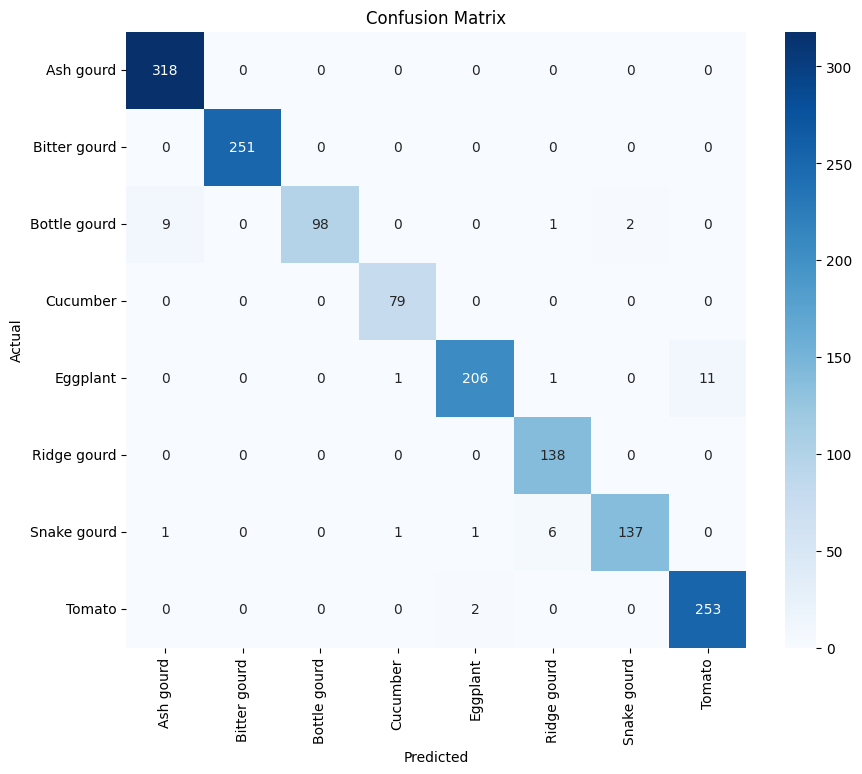

1/1 [==============================] - 2s 2s/step


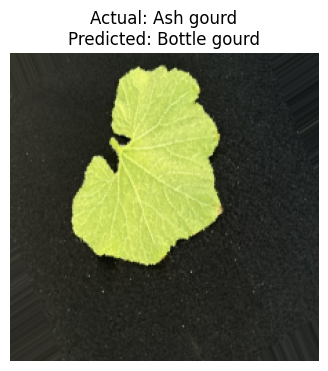

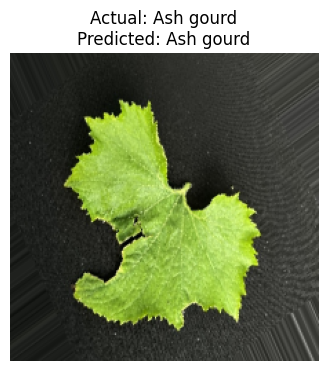

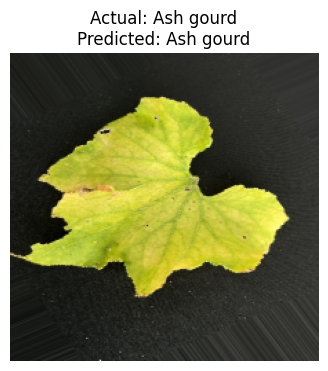

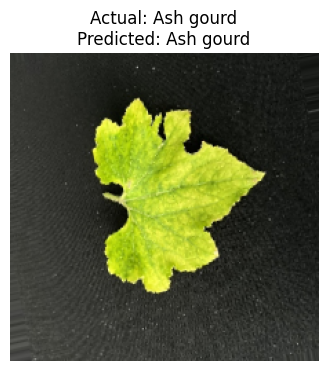

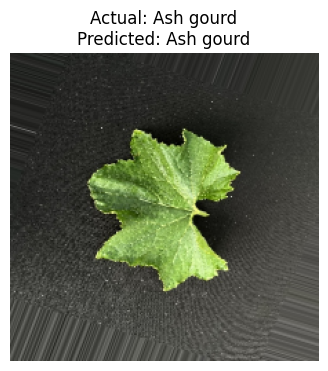

...

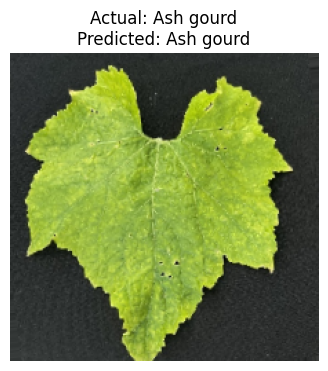

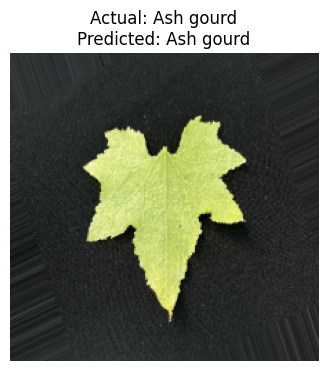

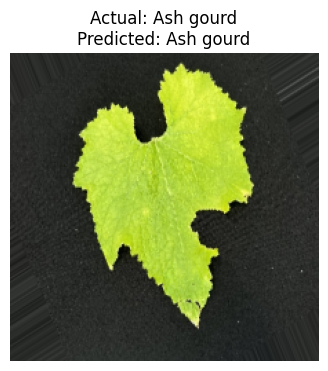

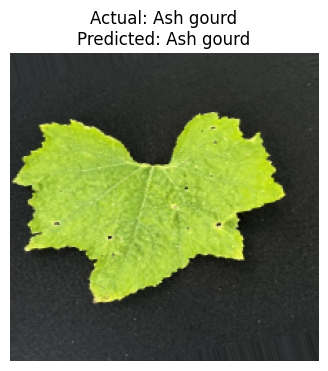

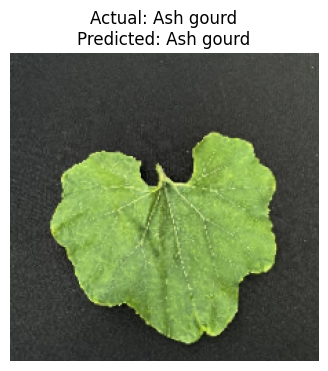

1/1 [==============================] - 1s 750ms/step


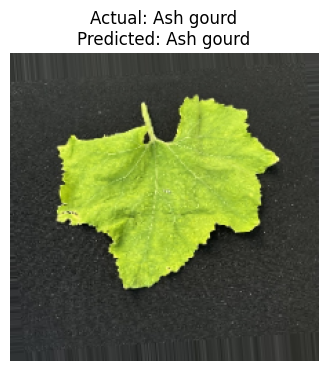

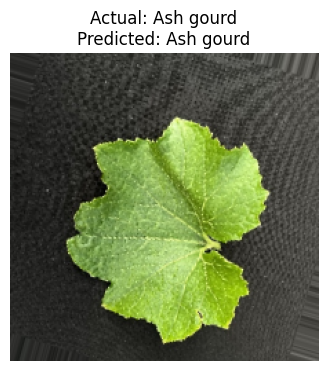

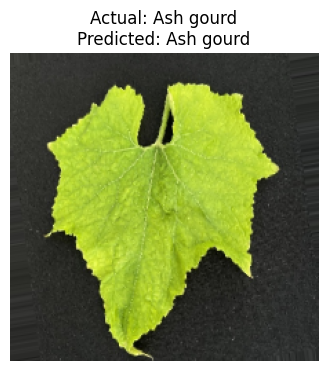

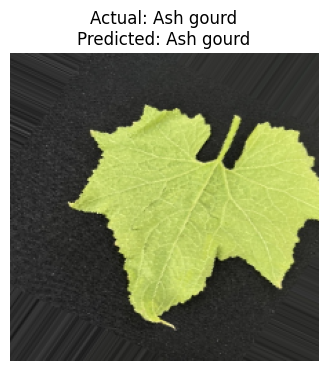

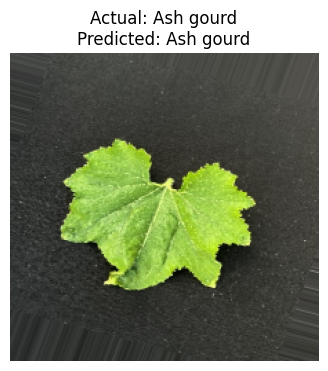

...

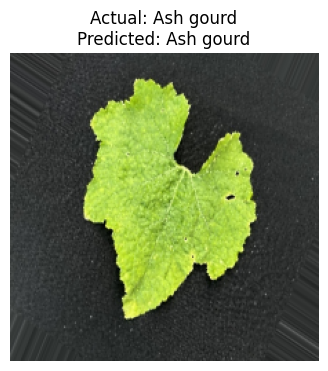

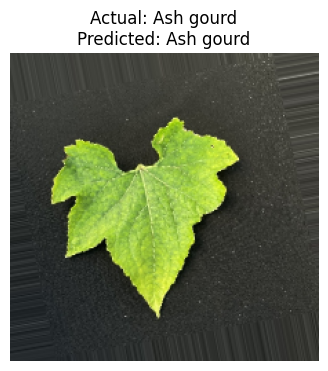

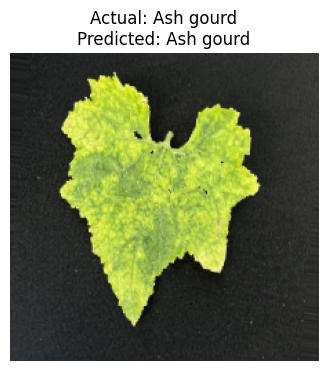

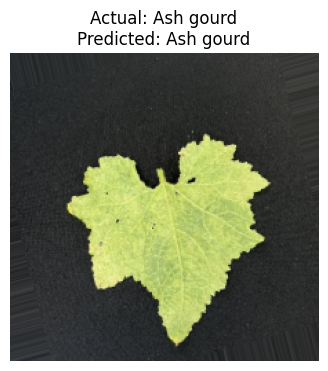

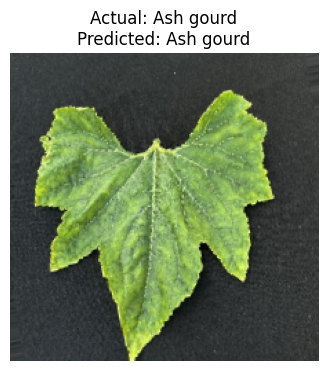

1/1 [==============================] - 1s 760ms/step


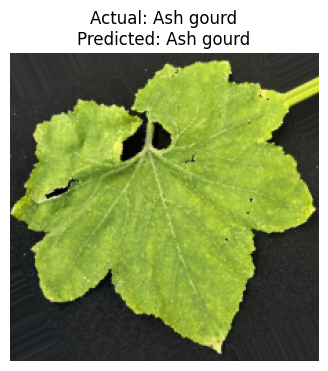

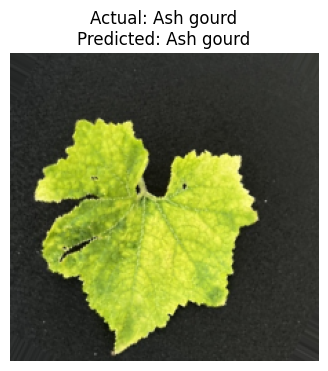

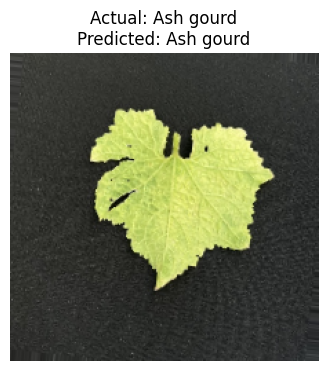

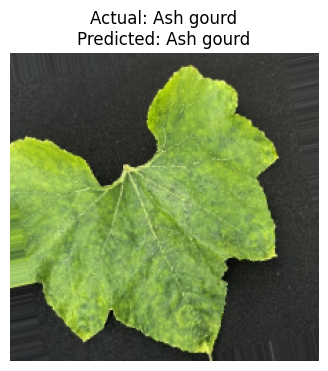

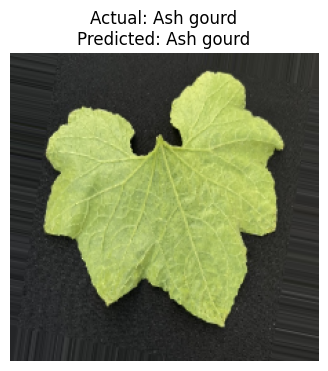

...

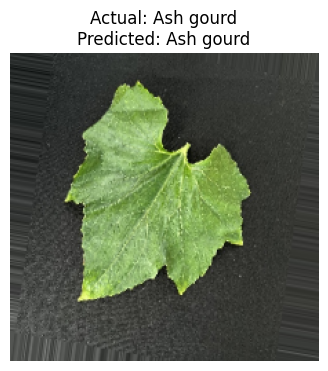

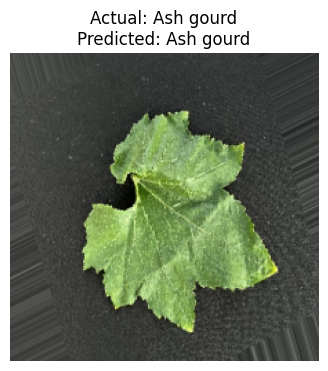

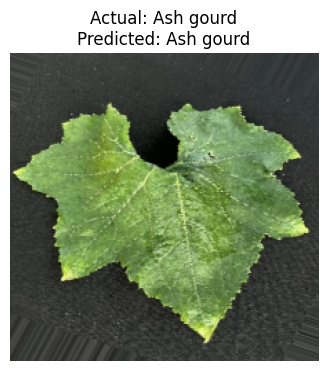

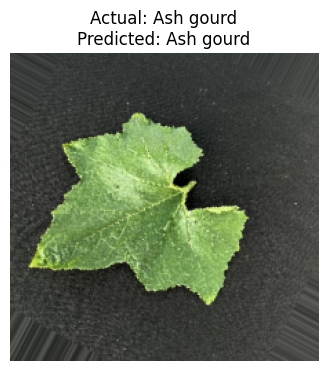

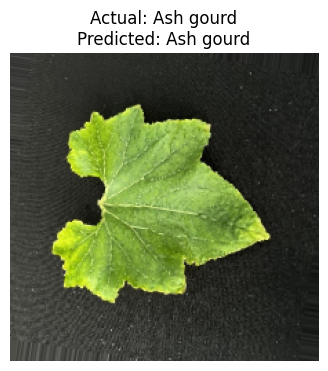

1/1 [==============================] - 1s 774ms/step


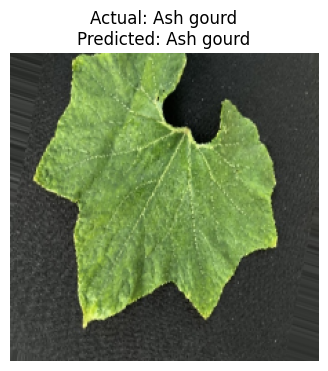

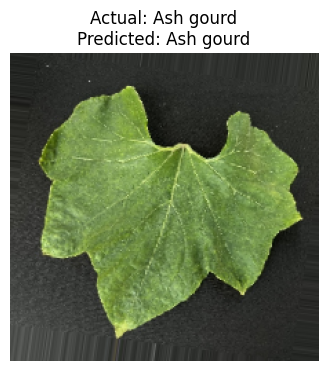

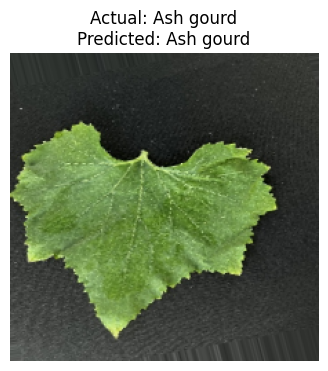

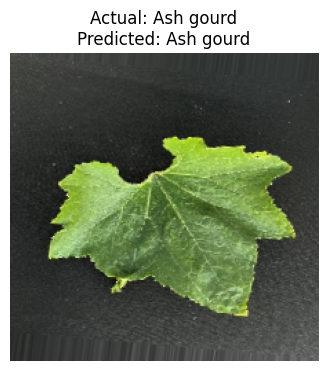

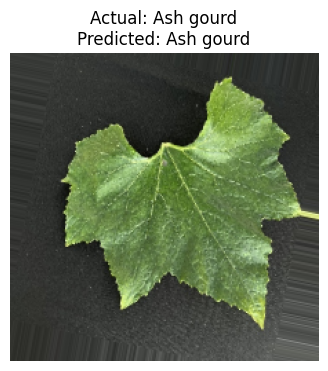

...

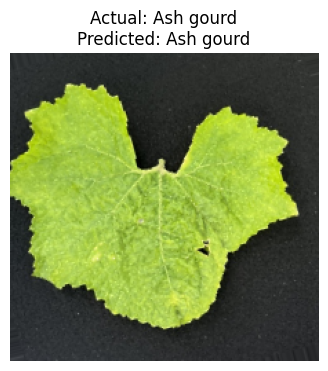

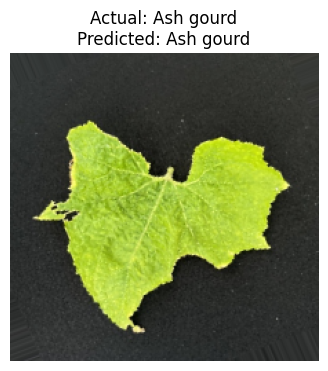

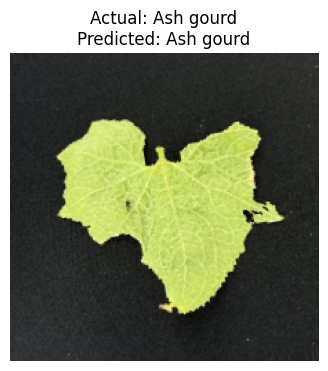

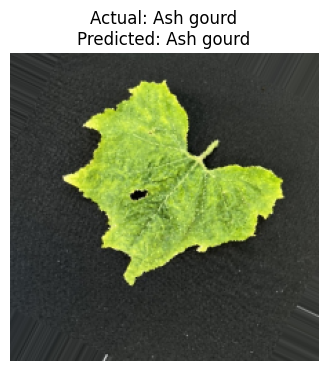

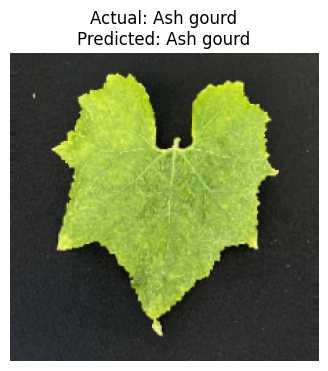

1/1 [==============================] - 1s 774ms/step


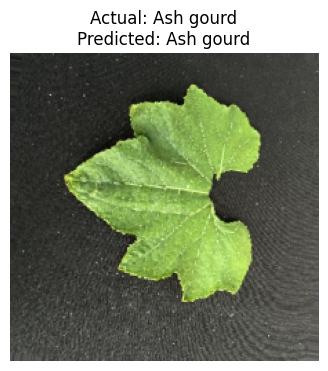

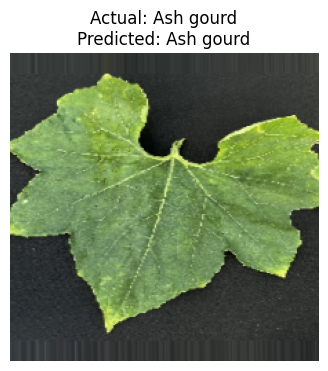

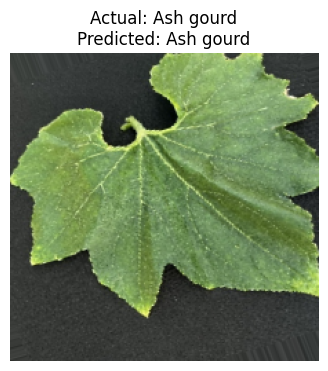

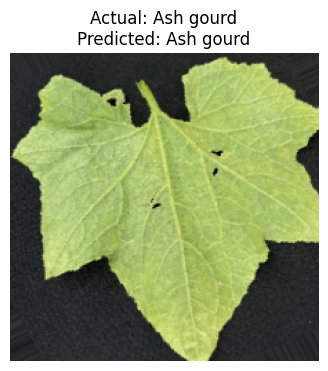

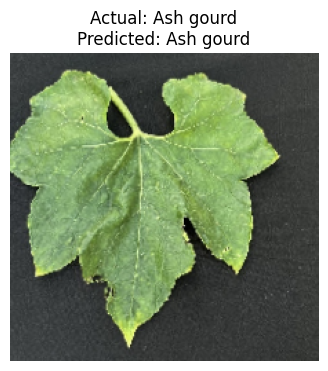

...

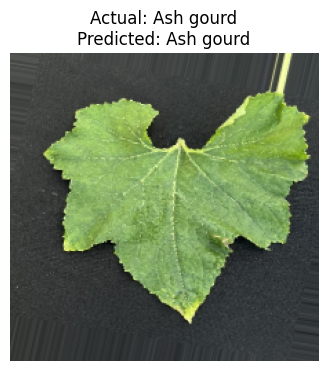

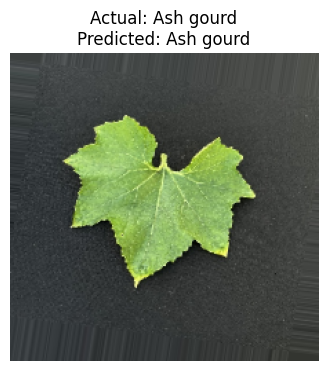

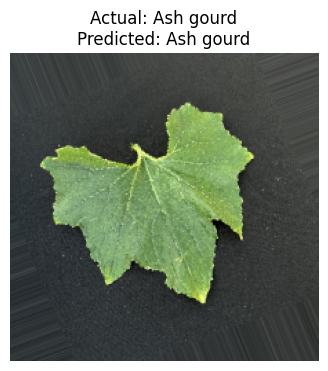

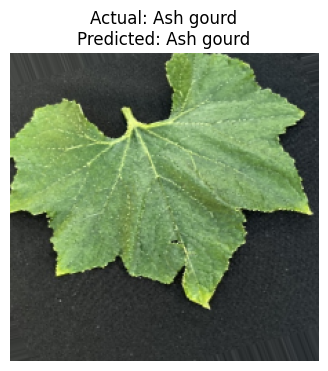

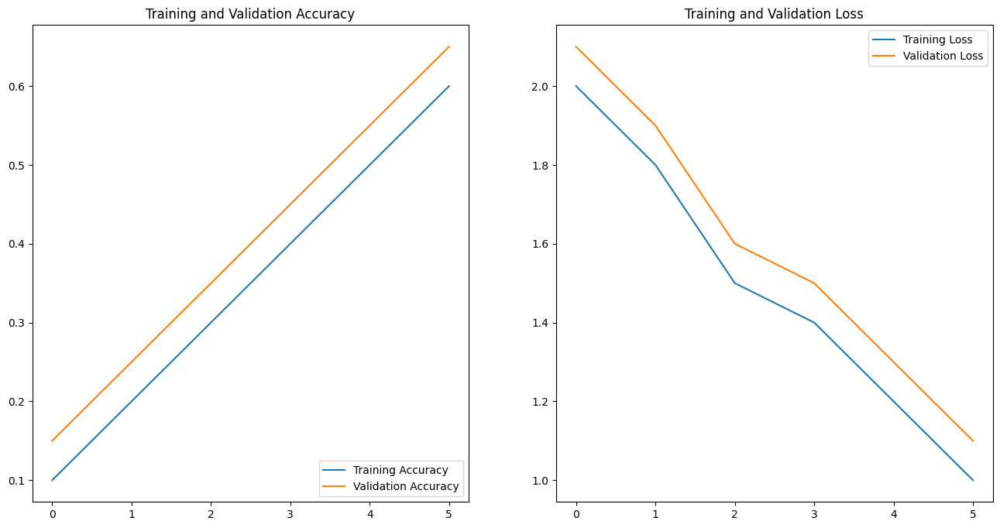

In [3]:
import os
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# Define paths
data_dir = "C:\\Users\\USER\\OneDrive\\Desktop\\pdd\\dataset"
batch_size = 32
img_height = 224
img_width = 224

# Data augmentation and preprocessing
datagen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.2,
    horizontal_flip=True,
    rotation_range=30,
    zoom_range=0.2,
    shear_range=0.2
)

# Create ImageDataGenerators
validation_generator = datagen.flow_from_directory(
    data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation',
    shuffle=False  # Important to get correct labels for the confusion matrix
)

# Load the best model
model = tf.keras.models.load_model('best_model_1.h5')

# Evaluate the model
val_loss, val_accuracy = model.evaluate(validation_generator)
print(f"Validation Accuracy: {val_accuracy * 100:.2f}%")

# Generate classification report
Y_pred = model.predict(validation_generator)
y_pred = np.argmax(Y_pred, axis=1)
print('Confusion Matrix')
cm = confusion_matrix(validation_generator.classes, y_pred)
print(cm)
print('Classification Report')
target_names = list(validation_generator.class_indices.keys())
print(classification_report(validation_generator.classes, y_pred, target_names=target_names))

# Plot confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

# Function to display sample predictions with health status
def display_predictions(generator, model, target_names, num_images=5):
    generator.reset()
    for _ in range(num_images):
        img, label = generator.next()
        prediction = model.predict(img)
        predicted_class = np.argmax(prediction, axis=1)
        actual_class = np.argmax(label, axis=1)
        
        for i in range(len(img)):
            plt.figure(figsize=(10, 4))
            plt.imshow(img[i])
            plt.title(f"Actual: {target_names[actual_class[i]]}\nPredicted: {target_names[predicted_class[i]]}")
            plt.axis('off')
            plt.show()

# Display predictions
display_predictions(validation_generator, model, target_names)

# If you saved the history during training, plot training & validation accuracy and loss
# Example history dictionaries
history = {
    'accuracy': [0.1, 0.2, 0.3],  # replace with your actual history data
    'val_accuracy': [0.15, 0.25, 0.35],
    'loss': [2.0, 1.8, 1.5],
    'val_loss': [2.1, 1.9, 1.6]
}
history_fine = {
    'accuracy': [0.4, 0.5, 0.6],  # replace with your actual history data
    'val_accuracy': [0.45, 0.55, 0.65],
    'loss': [1.4, 1.2, 1.0],
    'val_loss': [1.5, 1.3, 1.1]
}

# Concatenate history
acc = history['accuracy'] + history_fine['accuracy']
val_acc = history['val_accuracy'] + history_fine['val_accuracy']
loss = history['loss'] + history_fine['loss']
val_loss = history['val_loss'] + history_fine['val_loss']
epochs_range = range(len(acc))

plt.figure(figsize=(16, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()
